# Mounting Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive',force_remount=True)

Mounted at /content/drive


# Severstal: Steel Defect Detection


#7  Binary Segmentation classifier for each defect

In [ ]:
train_data.head(1)

,ImageId,Defect_1,Defect_2,Defect_3,Defect_4,has_defect,has_defect_1,has_defect_2,has_defect_3,has_defect_4,no_of_defects
0,0002cc93b.jpg,29102 12 29346 24 29602 24 29858 24 30114 24 3...,NaN,NaN,NaN,1,1,0,0,0,1


In [ ]:
X_train_data.head(1)

,ImageId,Defect_1,Defect_2,Defect_3,Defect_4,has_defect,has_defect_1,has_defect_2,has_defect_3,has_defect_4,no_of_defects
4494,5b922560e.jpg,NaN,NaN,NaN,NaN,0,0,0,0,0,0


##7.1 Creating Train, Test, Val data for each defect

In [ ]:
train_data_1 = X_train_data[X_train_data['has_defect_1']==1][['ImageId','Defect_1']]
train_data_2 = X_train_data[X_train_data['has_defect_2']==1][['ImageId','Defect_2']]
train_data_3 = X_train_data[X_train_data['has_defect_3']==1][['ImageId','Defect_3']]
train_data_4 = X_train_data[X_train_data['has_defect_4']==1][['ImageId','Defect_4']]

val_data_1 = X_val_data[X_val_data['has_defect_1']==1][['ImageId','Defect_1']]
val_data_2 = X_val_data[X_val_data['has_defect_2']==1][['ImageId','Defect_2']]
val_data_3 = X_val_data[X_val_data['has_defect_3']==1][['ImageId','Defect_3']]
val_data_4 = X_val_data[X_val_data['has_defect_4']==1][['ImageId','Defect_4']]

test_data_1 = X_test_data[X_test_data['has_defect_1']==1][['ImageId','Defect_1']]
test_data_2 = X_test_data[X_test_data['has_defect_2']==1][['ImageId','Defect_2']]
test_data_3 = X_test_data[X_test_data['has_defect_3']==1][['ImageId','Defect_3']]
test_data_4 = X_test_data[X_test_data['has_defect_4']==1][['ImageId','Defect_4']]

In [ ]:
print(X_train_data.shape, X_val_data.shape, X_test_data.shape)
print(train_data_1.shape,val_data_1.shape,test_data_1.shape)
print(train_data_2.shape,val_data_2.shape,test_data_2.shape)
print(train_data_3.shape,val_data_3.shape,test_data_3.shape)
print(train_data_4.shape,val_data_4.shape,test_data_4.shape)

(9048, 11) (2263, 11) (1257, 11)
(653, 2) (162, 2) (82, 2)
(173, 2) (50, 2) (24, 2)
(3711, 2) (922, 2) (517, 2)
(570, 2) (144, 2) (87, 2)


In [ ]:
train_data_1.head()

,ImageId,Defect_1
10572,d68320987.jpg,363892 4 364147 11 364402 19 364658 25 364913 ...
6291,7f52709ea.jpg,278100 9 278338 27 278576 45 278823 54 279079 ...
1611,1fed233e0.jpg,365900 5 366152 15 366404 25 366657 34 366909 ...
513,0a8cb8ddf.jpg,73424 18 73663 35 73919 35 74175 35 74431 35 7...
4280,57239737a.jpg,64271 7 64527 19 64783 32 65039 44 65295 51 65...


##7.2 Utility function to to convert mask2rle & rle2mask

In [ ]:
def mask2rle(mask):
  mask_flatten = mask.flatten(order = 'F')
  # We will create another mask shifted by one digit and compare side by side
  masks_flatten_append0 = np.concatenate([[0], mask_flatten, [0]])
  runs = np.where(masks_flatten_append0[1:] != masks_flatten_append0[:-1])[0]+1
  runs[1::2] -= runs[::2]
  return ' '.join(str(x) for x in runs)

@tf.function()
def tf_function_mask2rle(input):
  y = tf.numpy_function(mask2rle, [input], (tf.string))
  return y  

def rle2mask(rle,shape=(256,1600)):
  mask_label = np.zeros(shape[0]*shape[1],dtype=np.float32)
  if not isinstance(rle, str):
    rle = rle.decode("utf-8")
  if rle is not np.nan and rle is not '':
    masks = rle.split(" ")
    positions = map(int, masks[0::2])
    lengths = map(int, masks[1::2])
    for pos, le in zip(positions,lengths):
      mask_label[pos-1:pos+le-1] = 1.
    # print(mask_label.reshape(shape[0], shape[1], order='F').shape)
  return np.expand_dims(mask_label.reshape(shape[0], shape[1], order='F'),-1)

@tf.function()
def tf_function_rle2mask(input):
  y = tf.numpy_function(rle2mask, [input], (tf.float32))
  y = tf.reshape(y,shape=(256,1600,1))
  return y  

##7.3 Utility function to display images with defects

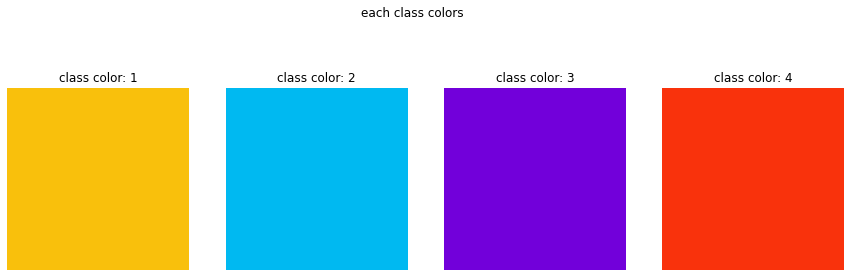

In [ ]:
train_path = Path("train_images/")
def show_mask_image(name, true_mask,a1,pred_mask,a2):
    img_true = cv2.imread(str(train_path / name))
    img_pred = cv2.imread(str(train_path / name))

    for ch in range(1):
 
        contours_pred, _ = cv2.findContours(pred_mask[:, :, ch], cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
        for i in range(0, len(contours_pred)):
            cv2.polylines(img_pred, contours_pred[i], True, palet[ch], 2)

        contours_true, _ = cv2.findContours(true_mask[:, :, ch], cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
        for i in range(0, len(contours_true)):
            cv2.polylines(img_true, contours_true[i], True, palet[ch], 2)

    a1.set_title(name)
    a1.imshow(img_true)
    a2.set_title(name)
    a2.imshow(img_pred)
    plt.show()

#https://www.kaggle.com/go1dfish/clear-mask-visualization-and-simple-eda
# Lets define a pallete 
palet = [(249, 192, 12), (0, 185, 241), (114, 0, 218), (249,50,12)]
fig, ax = plt.subplots(1, 4, figsize=(15, 5))
for i in range(4):
    ax[i].axis('off')
    ax[i].imshow(np.ones((50, 50, 3), dtype=np.uint8) * palet[i])
    ax[i].set_title("class color: {}".format(i+1))
fig.suptitle("each class colors")

plt.show()

##7.4 Creating Train, Val and Test batches

In [ ]:
#https://cs230.stanford.edu/blog/datapipeline/
#https://www.tensorflow.org/guide/data

base_path ='train_images/'

#function to read the image and convert into pixel
def parse_function(image_path,label):
  image_string = tf.io.read_file(base_path+image_path)

  #Don't use tf.image.decode_image, or the output shape will be undefined
  image = tf.image.decode_jpeg(image_string, channels=3)

  #This will convert to float values in [0, 1]
  image = tf.image.convert_image_dtype(image, tf.float32)
  
  # print(image)

  label = tf_function_rle2mask(label)
  # print(label)

  return image, label


#function to augment the images
def augment(image, label):
  image = tf.image.random_flip_left_right(image)
  image = tf.image.random_flip_up_down(image)
  image = tf.image.random_brightness(image, max_delta = 0.4)
  image = tf.image.random_crop(image, size=[224, 1568, 3])
  image = tf.clip_by_value(image, 0.0, 1.0)

  return image, label

#function to resize the images
def image_resize(image,label):
  resized_image = tf.image.resize(image, [256, 512])
  resized_image = tf.clip_by_value(resized_image, 0.0, 1.0)

  # print(label.shape)
  label =tf.cast(label,dtype='float32') 
  # print(label.shape)
  # lable = tf.image.decode_jpeg(label,channels=1)
  # label = tf.expand_dims(label,-1)
  # print(label.shape)
  resized_label = tf.image.resize(label, [256, 512])
  
  return resized_image, resized_label

##7.5 Importing Segmentation model

In [ ]:
!pip install segmentation_models

In [ ]:
import segmentation_models as sm
sm.set_framework('tf.keras')

Segmentation Models: using `keras` framework.


#8 Defect_1

##8.1 Train, Test and Val data

In [ ]:
X_train_1 = train_data_1['ImageId']
y_train_1 = train_data_1['Defect_1']
X_val_1 = val_data_1['ImageId']
y_val_1 = val_data_1['Defect_1']
X_test_1 = test_data_1['ImageId']
y_test_1 = test_data_1['Defect_1']

##8.2 Creating datset tensor

In [ ]:
train_dataset_1 = tf.data.Dataset.from_tensor_slices((X_train_1, y_train_1))
val_dataset_1 = tf.data.Dataset.from_tensor_slices((X_val_1, y_val_1))
test_dataset_1 = tf.data.Dataset.from_tensor_slices((X_test_1, y_test_1))

In [ ]:
for i in train_dataset_1.take(5):
  print(i)

(<tf.Tensor: shape=(), dtype=string, numpy=b'd68320987.jpg'>, <tf.Tensor: shape=(), dtype=string, numpy=b'363892 4 364147 11 364402 19 364658 25 364913 33 365168 40 365423 48 365678 55 365933 63 366189 69 366444 77 366699 84 366954 89 367211 88 367467 88 367724 87 367981 86 368238 85 368494 85 368751 85 369008 84 369267 81 369527 77 369787 73 370047 69 370307 65 370567 60 370828 54 371088 49 371348 44 371608 39 371868 34 372129 28 372389 23 372649 18 372909 13 373169 8 373429 3'>)
(<tf.Tensor: shape=(), dtype=string, numpy=b'7f52709ea.jpg'>, <tf.Tensor: shape=(), dtype=string, numpy=b'278100 9 278338 27 278576 45 278823 54 279079 54 279335 54 279591 54 279847 54 280103 54 280359 54 280615 54 280871 54 281127 54 281383 54 281639 54 281895 54 282151 55 282407 55 282555 5 282663 55 282801 15 282919 55 283047 25 283175 55 283293 35 283431 55 283544 40 283687 55 283800 40 283943 55 284056 40 284199 55 284312 40 284455 55 284568 40 284711 55 284824 40 284967 55 285080 40 285223 55 285336 40 

##8.3 Creating Train, Test and Val batches

In [ ]:
#https://www.tensorflow.org/tutorials/images/data_augmentation
BATCH_SIZE = 8
augmented_train_batches_segmentation_1 = (
    train_dataset_1
    .cache()
    .shuffle(X_train_1.shape[0]//4,reshuffle_each_iteration=True)
    # The augmentation is added here.
    .map(parse_function, num_parallel_calls=AUTOTUNE)
    # .map(augment, num_parallel_calls=AUTOTUNE)
    .map(image_resize)
    .batch(BATCH_SIZE)
    .prefetch(1)
)

val_batches_segmentation_1 = (
    val_dataset_1
    .cache()
    .map(parse_function, num_parallel_calls=AUTOTUNE)
    .map(image_resize)
    .batch(BATCH_SIZE)
    .prefetch(1)
)

test_batches_segmentation_1 = (
    test_dataset_1
    .cache()
    .map(parse_function, num_parallel_calls=AUTOTUNE)
    .map(image_resize)
    .batch(1)
    .prefetch(1)
)

augmented_test_batches_segmentation_1 = (
    test_dataset_1
    .cache()
    # The augmentation is added here.
    .map(parse_function, num_parallel_calls=AUTOTUNE)
    # .map(augment, num_parallel_calls=AUTOTUNE)
    .map(image_resize)
    .batch(1)
    .prefetch(1)
)

##8.4 Model summary

In [ ]:
from segmentation_models import Unet
#https://segmentation-models.readthedocs.io/en/latest/tutorial.htmlhttps://github.com/qubvel/segmentation_models
segmentation_model_1 = sm.Unet('efficientnetb1', input_shape= (256,512,3), classes=1, encoder_weights='imagenet', activation ='sigmoid')
segmentation_model_1.summary() 

27164672/27164032 [==============================] - 1s 0us/step
Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 256, 512, 3) 0                                            
__________________________________________________________________________________________________
stem_conv (Conv2D)              (None, 128, 256, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
stem_bn (BatchNormalization)    (None, 128, 256, 32) 128         stem_conv[0][0]                  
__________________________________________________________________________________________________
stem_activation (Activation)    (None, 128, 256, 32) 0           stem_bn[0][0]                    
_____________________________

In [ ]:
segmentation_model_1_optimizer = tf.keras.optimizers.Adam(1e-4)
start_epoch = tf.Variable(0)

##8.5 Checkpointing

In [ ]:
#https://www.tensorflow.org/guide/checkpoint
#Checkpointing model after every epoch
checkpoint = tf.train.Checkpoint(start_epoch=start_epoch, segmentation_model_1_optimizer = segmentation_model_1_optimizer,segmentation_model_1 = segmentation_model_1)
manager = tf.train.CheckpointManager(checkpoint, directory="./segmentation_model_1/tensorflow/checkpoints", max_to_keep=5)

In [ ]:
#https://www.tensorflow.org/tensorboard/get_started
#Checkpoinint loss and acc after every epoch for Tensorboard
# current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
train_log_dir = 'segmentation_model_1/tensorflow/logs/gradient_tape' + '/train'
val_log_dir = 'segmentation_model_1/tensorflow/logs/gradient_tape' + '/val'
train_summary_writer = tf.summary.create_file_writer(train_log_dir)
val_summary_writer = tf.summary.create_file_writer(val_log_dir)

##8.6 Training the model using gradient tape

In [ ]:
# Notice the use of `tf.function`
# This annotation causes the function to be "compiled" into a TF Graph
@tf.function
def train_step(images,labels):
    with tf.GradientTape() as model_tape:
      #Generating the model output
      model_output = segmentation_model_1(images,training=True)   
      #Calculating the model loss
      model_loss = dice_loss_differentiable(labels, model_output)

    gradients_of_model = model_tape.gradient(model_loss,segmentation_model_1.trainable_variables)
   
    segmentation_model_1_optimizer.apply_gradients(zip(gradients_of_model,segmentation_model_1.trainable_variables))
  

##8.7 Model Training

In [ ]:
def train_checkpoint_val(train_dataset_segmentation_1, epochs , val_dataset_segmentation_1):
  global start_epoch
  fig,ax = plt.subplots(1,1)
  ax.set_xlabel('epoch') ; ax.set_ylabel('Dice loss')
  xs, ytrs, yvals = [], [], []

  # Restoring from latest checkpoint if stored 
  checkpoint.restore(manager.latest_checkpoint)
  if manager.latest_checkpoint:
    print("Restored from {}".format(manager.latest_checkpoint))
  else:
    print("Initializing from scratch.")
   

  # Training the data 
  for epoch in range(start_epoch.numpy(), epochs):
    start = time.time()

    for images,labels in train_dataset_segmentation_1:
      # print(images.shape)
      # labels = tf.reshape(labels,(-1,1))
      # print(label.shape)
      train_step(images,labels) 
    
    stop = time.time()  
    
    #Increment the start_epoch to save it in checkpoint
    start_epoch.assign_add(1)
     
    # Save the model after every epoch 
    manager.save()

    segmentation_model_1.compile(optimizer=segmentation_model_1_optimizer, loss=dice_loss_differentiable, metrics=[dice_coef_differentiable,dice_coef])
    
    #Calculate train loss at the end of each epoch
    train_epoch_dice_loss_differentiable, train_epoch_dice_coef_differentiable ,train_epoch_dice_coef = segmentation_model_1.evaluate(train_dataset_segmentation_1,verbose=0)
    
    # Save the loss and acc for train
    with train_summary_writer.as_default():
      tf.summary.scalar('dice_loss_differentiable', train_epoch_dice_loss_differentiable, step=epoch)
      tf.summary.scalar('dice_coef_differentiable', train_epoch_dice_coef_differentiable, step=epoch) 
      tf.summary.scalar('dice_coef', train_epoch_dice_coef, step=epoch)   
     
    #Calculate val loss at the end of each epoch
    val_epoch_dice_loss_differentiable, val_epoch_dice_coef_differentiable , val_epoch_dice_coef = segmentation_model_1.evaluate(val_dataset_segmentation_1,verbose=0)

    # Save the loss and acc for val
    with val_summary_writer.as_default():
      tf.summary.scalar('dice_loss_differentiable', val_epoch_dice_loss_differentiable, step=epoch)
      tf.summary.scalar('dice_coef_differentiable', val_epoch_dice_coef_differentiable, step=epoch)  
      tf.summary.scalar('dice_coef', val_epoch_dice_coef, step=epoch)  
      

    xs.append(epoch+1)
    ytrs.append(train_epoch_dice_loss_differentiable)
    yvals.append(val_epoch_dice_loss_differentiable)   

    print ('epoch: {} - time: {} sec - train_dice_loss_differentiable: {} - train_dice_coef_differentiable: {} - train_dice_coef: {} - \
            val_dice_loss_differentiable: {} - val_dice_coef_differentiable: {} - val_dice_coef: {}-'.format(\
           epoch + 1, np.round(stop-start) ,np.round(train_epoch_dice_loss_differentiable,2),np.round(train_epoch_dice_coef_differentiable,2),np.round(train_epoch_dice_coef,2),
           np.round(val_epoch_dice_loss_differentiable,2),np.round(val_epoch_dice_coef_differentiable,2),np.round(val_epoch_dice_coef,2)))
  plt_dynamic(xs, ytrs, yvals, ax, fig)

Initializing from scratch.
epoch: 1 - time: 117.0 sec - train_dice_loss_differentiable: 0.96 - train_dice_coef_differentiable: 0.04 - train_dice_coef: 0.08 -             val_dice_loss_differentiable: 0.96 - val_dice_coef_differentiable: 0.04 - val_dice_coef: 0.08-
epoch: 2 - time: 24.0 sec - train_dice_loss_differentiable: 0.89 - train_dice_coef_differentiable: 0.11 - train_dice_coef: 0.35 -             val_dice_loss_differentiable: 0.89 - val_dice_coef_differentiable: 0.11 - val_dice_coef: 0.35-
epoch: 3 - time: 23.0 sec - train_dice_loss_differentiable: 0.84 - train_dice_coef_differentiable: 0.16 - train_dice_coef: 0.52 -             val_dice_loss_differentiable: 0.84 - val_dice_coef_differentiable: 0.16 - val_dice_coef: 0.53-
epoch: 4 - time: 23.0 sec - train_dice_loss_differentiable: 0.78 - train_dice_coef_differentiable: 0.22 - train_dice_coef: 0.56 -             val_dice_loss_differentiable: 0.79 - val_dice_coef_differentiable: 0.21 - val_dice_coef: 0.54-
epoch: 5 - time: 23.0 se

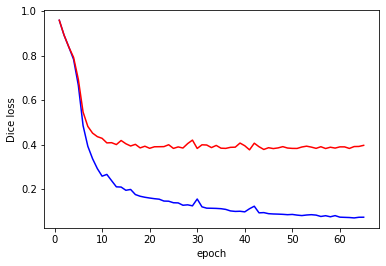

In [ ]:
train_checkpoint_val(augmented_train_batches_segmentation_1, 65, val_batches_segmentation_1)

In [ ]:
checkpoint.restore('./segmentation_model_1/tensorflow/checkpoints/ckpt-41')


In [ ]:
segmentation_model_1.save('segmentation_model_1/tensorflow/bst_model41.ckpt')


Instructions for updating:
If using Keras pass *_constraint arguments to layers.
INFO:tensorflow:Assets written to: segmentation_model_1/tensorflow/bst_model41.ckpt/assets


##8.8 Tensorboard

In [ ]:
%tensorboard --logdir segmentation_model_1/tensorflow/

<IPython.core.display.Javascript object>

In [ ]:
segmentation_model_1_restored = load_model('segmentation_model_1/tensorflow/bst_model41.ckpt',custom_objects=dependencies_segmentation)

##8.9 Evaluating on Test data dataset to see if the model us reproducible

In [ ]:
score = segmentation_model_1_restored.evaluate(val_batches_segmentation_1,verbose=1) 
print("Validation Dice Loss:", score[0])
print("Validation Dice Coeff: ", score[1])

21/21 [==============================] - 1s 56ms/step - loss: 0.3763 - dice_coef_differentiable: 0.6270 - dice_coef: 0.6286
Validation Dice Loss: 0.37625983357429504
Validation Dice Coeff:  0.6269585490226746


In [ ]:
y_pred_prob= segmentation_model_1_restored.predict(test_batches_segmentation_1,verbose=1)
print(y_pred_prob.shape) 

82/82 [==============================] - 7s 90ms/step
(82, 256, 512, 1)


In [ ]:
print("Binary accuracy is :",sum([0 if i==0 else 1 for i in (y_pred_prob>0.5).astype(int).sum(axis=1).sum(axis=1).sum(axis=1)])/82)

Binary accuracy is : 0.9878048780487805


##8. 10 Displaying original and predicted Images

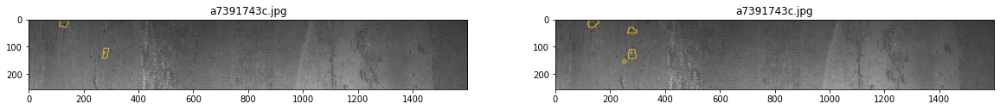

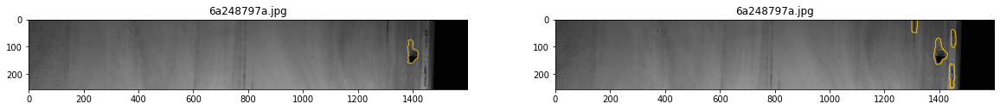

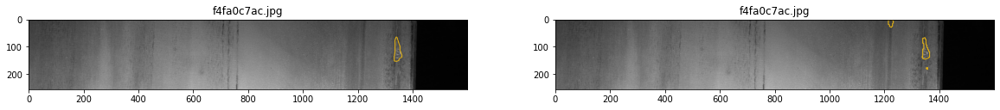

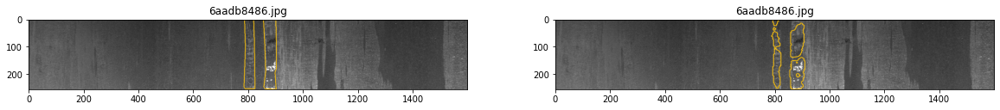

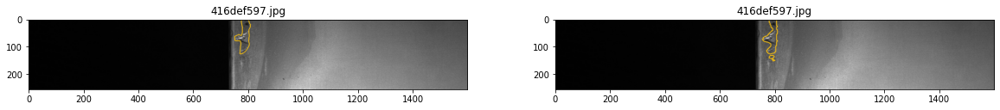

...

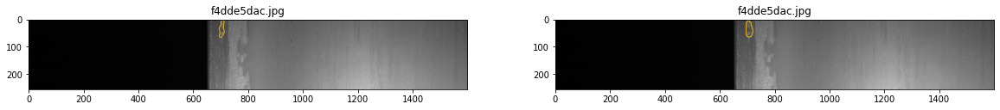

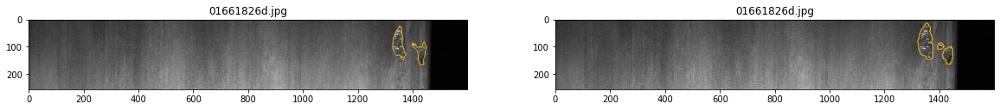

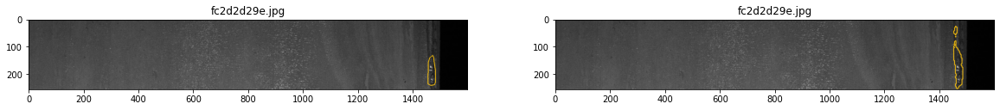

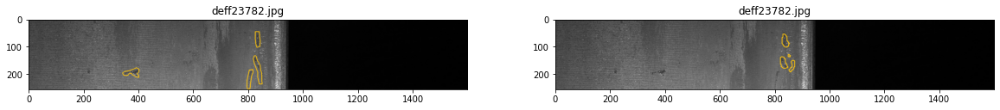

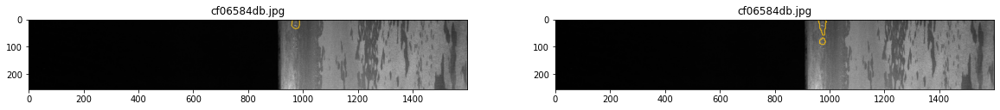

In [ ]:
for i in range(len(test_data_1.head(20))):
  fig, (a1,a2) = plt.subplots(1,2,figsize=(20, 20))
  name =test_data_1.iloc[i:i+1,:]['ImageId'].values[0]
  # print(type(name))
  # print(name)
  rle = test_data_1.iloc[i:i+1,:].iloc[:,1].iloc[0]
  # print(type(rle)) 
  true_mask = rle2mask(rle, (256,1600))
  true_mask = true_mask.astype('uint8')
  # true_mask = np.expand_dims(true_mask, -1)
  # print(true_mask.shape)
  pred_mask = (y_pred_prob[i,:,:,:]>0.5).astype(int).astype('uint8')
  # print(pred_mask.shape)
  pred_mask = cv2.resize(pred_mask,(1600,256))
  pred_mask = np.expand_dims(pred_mask, -1)
  # print(pred_mask.shape)
  show_mask_image(name,true_mask,a1,pred_mask,a2)
   

#9 Defect_2

##9.1 Train, Test and Val data

In [ ]:
X_train_2 = train_data_2['ImageId']
y_train_2 = train_data_2['Defect_2']
X_val_2 = val_data_2['ImageId']
y_val_2 = val_data_2['Defect_2']
X_test_2 = test_data_2['ImageId']
y_test_2 = test_data_2['Defect_2']


##9.2 Creating datset tensor

In [ ]:
train_dataset_2 = tf.data.Dataset.from_tensor_slices((X_train_2, y_train_2))
val_dataset_2 = tf.data.Dataset.from_tensor_slices((X_val_2, y_val_2))
test_dataset_2 = tf.data.Dataset.from_tensor_slices((X_test_2, y_test_2))

##9.3 Creating Train, Test and Val batches

In [ ]:
#https://www.tensorflow.org/tutorials/images/data_augmentation
BATCH_SIZE = 8
augmented_train_batches_segmentation_2 = (
    train_dataset_2
    .cache()
    .shuffle(X_train_2.shape[0]//4,reshuffle_each_iteration=True)
    # The augmentation is added here.
    .map(parse_function, num_parallel_calls=AUTOTUNE)
    # .map(augment, num_parallel_calls=AUTOTUNE)
    .map(image_resize)
    .batch(BATCH_SIZE)
    .prefetch(1)
)

val_batches_segmentation_2 = (
    val_dataset_2
    .cache()
    .map(parse_function, num_parallel_calls=AUTOTUNE)
    .map(image_resize)
    .batch(BATCH_SIZE)
    .prefetch(1)
)

test_batches_segmentation_2 = (
    test_dataset_2
    .cache()
    .map(parse_function, num_parallel_calls=AUTOTUNE)
    .map(image_resize)
    .batch(1)
    .prefetch(1)
)

augmented_test_batches_segmentation_2 = (
    test_dataset_2
    .cache()
    # The augmentation is added here.
    .map(parse_function, num_parallel_calls=AUTOTUNE)
    # .map(augment, num_parallel_calls=AUTOTUNE)
    .map(image_resize)
    .batch(1)
    .prefetch(1)
)

##9.4 Model summary

In [ ]:
from segmentation_models import Unet
#https://segmentation-models.readthedocs.io/en/latest/tutorial.htmlhttps://github.com/qubvel/segmentation_models
segmentation_model_2 = sm.Unet('efficientnetb1', input_shape= (256,512,3), classes=1, encoder_weights='imagenet', activation ='sigmoid')
segmentation_model_2.summary() 

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 256, 512, 3) 0                                            
__________________________________________________________________________________________________
stem_conv (Conv2D)              (None, 128, 256, 32) 864         input_3[0][0]                    
__________________________________________________________________________________________________
stem_bn (BatchNormalization)    (None, 128, 256, 32) 128         stem_conv[0][0]                  
__________________________________________________________________________________________________
stem_activation (Activation)    (None, 128, 256, 32) 0           stem_bn[0][0]                    
____________________________________________________________________________________________

In [ ]:
segmentation_model_2_optimizer = tf.keras.optimizers.Adam(1e-4)
start_epoch = tf.Variable(0)

In [ ]:
#https://www.tensorflow.org/guide/checkpoint
#Checkpointing model after every epoch
checkpoint = tf.train.Checkpoint(start_epoch=start_epoch, segmentation_model_2_optimizer = segmentation_model_2_optimizer,segmentation_model_2 = segmentation_model_2)
manager = tf.train.CheckpointManager(checkpoint, directory="./segmentation_model_2/tensorflow/checkpoints", max_to_keep=5)


##9.5 Checkpointing

In [ ]:
#https://www.tensorflow.org/tensorboard/get_started
#Checkpoinint loss and acc after every epoch for Tensorboard
# current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
train_log_dir = 'segmentation_model_2/tensorflow/logs/gradient_tape' + '/train'
val_log_dir = 'segmentation_model_2/tensorflow/logs/gradient_tape' + '/val'
train_summary_writer = tf.summary.create_file_writer(train_log_dir)
val_summary_writer = tf.summary.create_file_writer(val_log_dir)

##9.6 Training the model using gradient tape

In [ ]:
# Notice the use of `tf.function`
# This annotation causes the function to be "compiled" into a TF Graph
@tf.function
def train_step(images,labels):
    with tf.GradientTape() as model_tape:
      #Generating the model output
      model_output = segmentation_model_2(images,training=True)   
      #Calculating the model loss
      model_loss = dice_loss_differentiable(labels, model_output)

    gradients_of_model = model_tape.gradient(model_loss,segmentation_model_2.trainable_variables)
   
    segmentation_model_2_optimizer.apply_gradients(zip(gradients_of_model,segmentation_model_2.trainable_variables))
  

##9.7 Model Training

In [ ]:
def train_checkpoint_val(train_dataset_segmentation_2, epochs , val_dataset_segmentation_2):
  global start_epoch
  fig,ax = plt.subplots(1,1)
  ax.set_xlabel('epoch') ; ax.set_ylabel('Dice loss')
  xs, ytrs, yvals = [], [], []

  # Restoring from latest checkpoint if stored 
  checkpoint.restore(manager.latest_checkpoint)
  if manager.latest_checkpoint:
    print("Restored from {}".format(manager.latest_checkpoint))
  else:
    print("Initializing from scratch.")
   

  # Training the data 
  for epoch in range(start_epoch.numpy(), epochs):
    start = time.time()

    for images,labels in train_dataset_segmentation_2:
      # print(images.shape)
      # labels = tf.reshape(labels,(-1,1))
      # print(label.shape)
      train_step(images,labels) 
    
    stop = time.time()  
    
    #Increment the start_epoch to save it in checkpoint
    start_epoch.assign_add(1)
     
    # Save the model after every epoch 
    manager.save()

    segmentation_model_2.compile(optimizer=segmentation_model_2_optimizer, loss=dice_loss_differentiable, metrics=[dice_coef_differentiable,dice_coef])
    
    #Calculate train loss at the end of each epoch
    train_epoch_dice_loss_differentiable, train_epoch_dice_coef_differentiable ,train_epoch_dice_coef = segmentation_model_2.evaluate(train_dataset_segmentation_2,verbose=0)
    
    # Save the loss and acc for train
    with train_summary_writer.as_default():
      tf.summary.scalar('dice_loss_differentiable', train_epoch_dice_loss_differentiable, step=epoch)
      tf.summary.scalar('dice_coef_differentiable', train_epoch_dice_coef_differentiable, step=epoch) 
      tf.summary.scalar('dice_coef', train_epoch_dice_coef, step=epoch)   
     
    #Calculate val loss at the end of each epoch
    val_epoch_dice_loss_differentiable, val_epoch_dice_coef_differentiable , val_epoch_dice_coef = segmentation_model_2.evaluate(val_dataset_segmentation_2,verbose=0)

    # Save the loss and acc for val
    with val_summary_writer.as_default():
      tf.summary.scalar('dice_loss_differentiable', val_epoch_dice_loss_differentiable, step=epoch)
      tf.summary.scalar('dice_coef_differentiable', val_epoch_dice_coef_differentiable, step=epoch)  
      tf.summary.scalar('dice_coef', val_epoch_dice_coef, step=epoch)  
      

    xs.append(epoch+1)
    ytrs.append(train_epoch_dice_loss_differentiable)
    yvals.append(val_epoch_dice_loss_differentiable)   

    print ('epoch: {} - time: {} sec - train_dice_loss_differentiable: {} - train_dice_coef_differentiable: {} - train_dice_coef: {} - \
            val_dice_loss_differentiable: {} - val_dice_coef_differentiable: {} - val_dice_coef: {}-'.format(\
           epoch + 1, np.round(stop-start) ,np.round(train_epoch_dice_loss_differentiable,2),np.round(train_epoch_dice_coef_differentiable,2),np.round(train_epoch_dice_coef,2),
           np.round(val_epoch_dice_loss_differentiable,2),np.round(val_epoch_dice_coef_differentiable,2),np.round(val_epoch_dice_coef,2)))
  plt_dynamic(xs, ytrs, yvals, ax, fig)

Initializing from scratch.
epoch: 1 - time: 28.0 sec - train_dice_loss_differentiable: 0.98 - train_dice_coef_differentiable: 0.02 - train_dice_coef: 0.02 -             val_dice_loss_differentiable: 0.98 - val_dice_coef_differentiable: 0.02 - val_dice_coef: 0.02-
epoch: 2 - time: 6.0 sec - train_dice_loss_differentiable: 0.98 - train_dice_coef_differentiable: 0.02 - train_dice_coef: 0.02 -             val_dice_loss_differentiable: 0.98 - val_dice_coef_differentiable: 0.02 - val_dice_coef: 0.02-
epoch: 3 - time: 6.0 sec - train_dice_loss_differentiable: 0.98 - train_dice_coef_differentiable: 0.02 - train_dice_coef: 0.02 -             val_dice_loss_differentiable: 0.98 - val_dice_coef_differentiable: 0.02 - val_dice_coef: 0.02-
epoch: 4 - time: 6.0 sec - train_dice_loss_differentiable: 0.98 - train_dice_coef_differentiable: 0.02 - train_dice_coef: 0.02 -             val_dice_loss_differentiable: 0.98 - val_dice_coef_differentiable: 0.02 - val_dice_coef: 0.02-
epoch: 5 - time: 6.0 sec - t

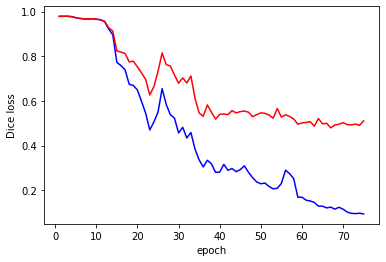

In [ ]:
train_checkpoint_val(augmented_train_batches_segmentation_2, 75, val_batches_segmentation_2)

In [ ]:
checkpoint.restore('./segmentation_model_2/tensorflow/checkpoints/ckpt-63')


In [ ]:
segmentation_model_2.save('segmentation_model_2/tensorflow/bst_model63.ckpt')


INFO:tensorflow:Assets written to: segmentation_model_2/tensorflow/bst_model63.ckpt/assets


##9.8 Tensorboard

In [ ]:
%tensorboard --logdir segmentation_model_2/tensorflow/

<IPython.core.display.Javascript object>

In [ ]:
segmentation_model_2_restored = load_model('segmentation_model_2/tensorflow/bst_model63.ckpt',custom_objects=dependencies_segmentation)

##9.9 Evaluating on Test data dataset to see if the model us reproducible

In [ ]:
score = segmentation_model_2_restored.evaluate(val_batches_segmentation_2,verbose=1) 
print("Validation Dice Loss:", score[0])
print("Validation Dice Coeff: ", score[1])

7/7 [==============================] - 0s 49ms/step - loss: 0.4868 - dice_coef_differentiable: 0.5238 - dice_coef: 0.5343
Validation Dice Loss: 0.48675963282585144
Validation Dice Coeff:  0.5237520933151245


In [ ]:
y_pred_prob= segmentation_model_2_restored.predict(test_batches_segmentation_2,verbose=1)
print(y_pred_prob.shape) 

24/24 [==============================] - 3s 116ms/step
(24, 256, 512, 1)


##9. 10 Displaying original and predicted Images

In [ ]:
print("Binary accuracy is :",sum([0 if i==0 else 1 for i in (y_pred_prob>0.5).astype(int).sum(axis=1).sum(axis=1).sum(axis=1)])/24)

Binary accuracy is : 1.0


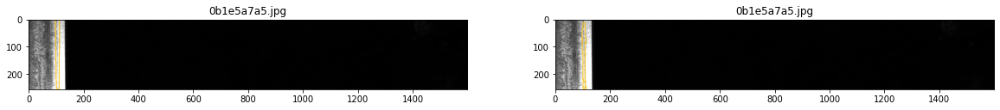

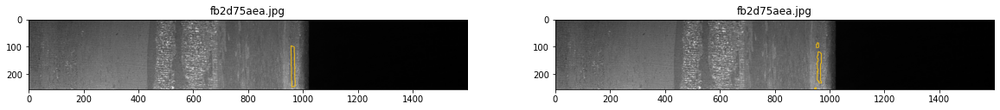

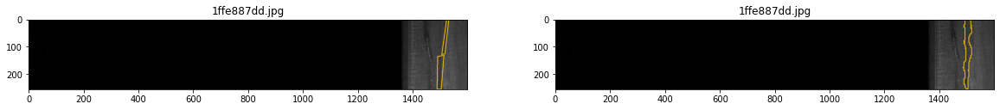

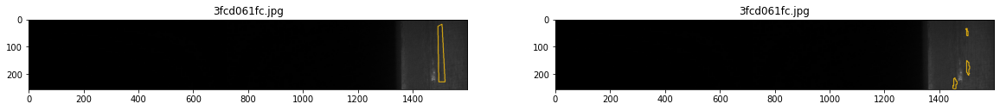

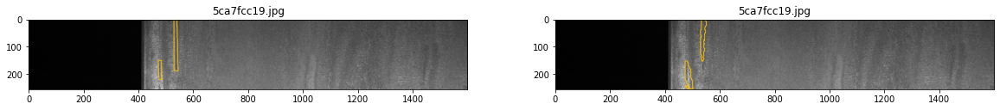

...

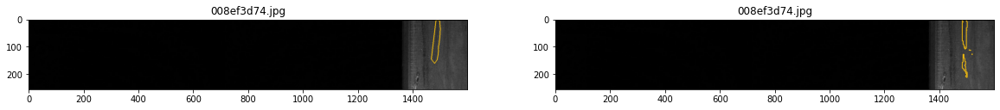

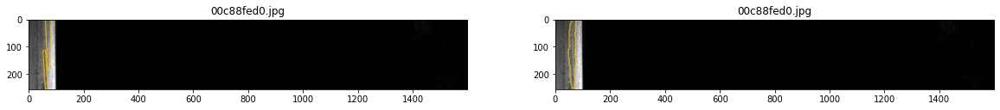

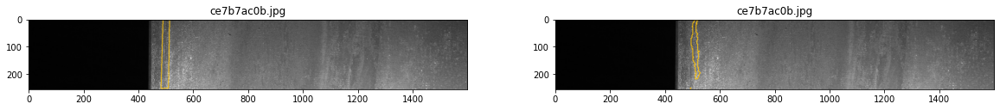

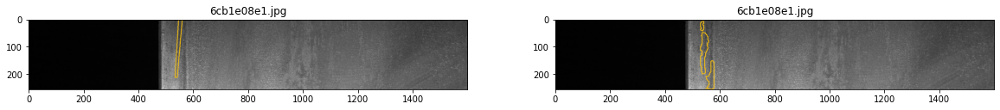

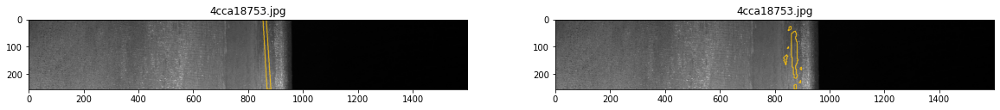

In [ ]:
for i in range(len(test_data_2.head(20))):
  fig, (a1,a2) = plt.subplots(1,2,figsize=(20, 20))
  name =test_data_2.iloc[i:i+1,:]['ImageId'].values[0]
  # print(type(name))
  # print(name)
  rle = test_data_2.iloc[i:i+1,:].iloc[:,1].iloc[0]
  # print(type(rle)) 
  true_mask = rle2mask(rle, (256,1600))
  true_mask = true_mask.astype('uint8')
  # true_mask = np.expand_dims(true_mask, -1)
  # print(true_mask.shape)
  pred_mask = (y_pred_prob[i,:,:,:]>0.5).astype(int).astype('uint8')
  # print(pred_mask.shape)
  pred_mask = cv2.resize(pred_mask,(1600,256))
  pred_mask = np.expand_dims(pred_mask, -1)
  # print(pred_mask.shape)
  show_mask_image(name,true_mask,a1,pred_mask,a2)
   

# Defect_3

##10.1 Train, Test and Val data

In [ ]:
X_train_3 = train_data_3['ImageId']
y_train_3 = train_data_3['Defect_3']
X_val_3 = val_data_3['ImageId']
y_val_3 = val_data_3['Defect_3']
X_test_3 = test_data_3['ImageId']
y_test_3 = test_data_3['Defect_3']

##10.2 Creating datset tensor

In [ ]:
train_dataset_3 = tf.data.Dataset.from_tensor_slices((X_train_3, y_train_3))
val_dataset_3 = tf.data.Dataset.from_tensor_slices((X_val_3, y_val_3))
test_dataset_3 = tf.data.Dataset.from_tensor_slices((X_test_3, y_test_3))

##10.3 Creating Train, Test and Val batches

In [ ]:
#https://www.tensorflow.org/tutorials/images/data_augmentation
BATCH_SIZE = 8
augmented_train_batches_segmentation_3 = (
    train_dataset_3
    .cache()
    .shuffle(X_train_3.shape[0]//4,reshuffle_each_iteration=True)
    # The augmentation is added here.
    .map(parse_function, num_parallel_calls=AUTOTUNE)
    # .map(augment, num_parallel_calls=AUTOTUNE)
    .map(image_resize)
    .batch(BATCH_SIZE)
    .prefetch(1)
)

val_batches_segmentation_3 = (
    val_dataset_3
    .cache()
    .map(parse_function, num_parallel_calls=AUTOTUNE)
    .map(image_resize)
    .batch(BATCH_SIZE)
    .prefetch(1)
)

test_batches_segmentation_3 = (
    test_dataset_3
    .cache()
    .map(parse_function, num_parallel_calls=AUTOTUNE)
    .map(image_resize)
    .batch(1)
    .prefetch(1)
)

augmented_test_batches_segmentation_3 = (
    test_dataset_3
    .cache()
    # The augmentation is added here.
    .map(parse_function, num_parallel_calls=AUTOTUNE)
    # .map(augment, num_parallel_calls=AUTOTUNE)
    .map(image_resize)
    .batch(1)
    .prefetch(1)
)

##10.4 Model summary

In [ ]:
from segmentation_models import Unet
#https://segmentation-models.readthedocs.io/en/latest/tutorial.htmlhttps://github.com/qubvel/segmentation_models
segmentation_model_3 = sm.Unet('efficientnetb1', input_shape= (256,512,3), classes=1, encoder_weights='imagenet', activation ='sigmoid')
segmentation_model_3.summary() 

Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 256, 512, 3) 0                                            
__________________________________________________________________________________________________
stem_conv (Conv2D)              (None, 128, 256, 32) 864         input_4[0][0]                    
__________________________________________________________________________________________________
stem_bn (BatchNormalization)    (None, 128, 256, 32) 128         stem_conv[0][0]                  
__________________________________________________________________________________________________
stem_activation (Activation)    (None, 128, 256, 32) 0           stem_bn[0][0]                    
____________________________________________________________________________________________

In [ ]:
segmentation_model_3_optimizer = tf.keras.optimizers.Adam(1e-4)
start_epoch = tf.Variable(0)

##10.5 Checkpointing

In [ ]:
#https://www.tensorflow.org/guide/checkpoint
#Checkpointing model after every epoch
checkpoint = tf.train.Checkpoint(start_epoch=start_epoch, segmentation_model_3_optimizer = segmentation_model_3_optimizer,segmentation_model_3 = segmentation_model_3)
manager = tf.train.CheckpointManager(checkpoint, directory="./segmentation_model_3/tensorflow/checkpoints", max_to_keep=5)

In [ ]:
#https://www.tensorflow.org/tensorboard/get_started
#Checkpoinint loss and acc after every epoch for Tensorboard
# current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
train_log_dir = 'segmentation_model_3/tensorflow/logs/gradient_tape' + '/train'
val_log_dir = 'segmentation_model_3/tensorflow/logs/gradient_tape' + '/val'
train_summary_writer = tf.summary.create_file_writer(train_log_dir)
val_summary_writer = tf.summary.create_file_writer(val_log_dir)

##10.6 Training the model using gradient tape

In [ ]:
# Notice the use of `tf.function`
# This annotation causes the function to be "compiled" into a TF Graph
@tf.function
def train_step(images,labels):
    with tf.GradientTape() as model_tape:
      #Generating the model output
      model_output = segmentation_model_3(images,training=True)   
      #Calculating the model loss
      model_loss = dice_loss_differentiable(labels, model_output)

    gradients_of_model = model_tape.gradient(model_loss,segmentation_model_3.trainable_variables)
   
    segmentation_model_3_optimizer.apply_gradients(zip(gradients_of_model,segmentation_model_3.trainable_variables))
  

##10.7 Model Training

In [ ]:
def train_checkpoint_val(train_dataset_segmentation_3, epochs , val_dataset_segmentation_3):
  global start_epoch
  fig,ax = plt.subplots(1,1)
  ax.set_xlabel('epoch') ; ax.set_ylabel('Dice loss')
  xs, ytrs, yvals = [], [], []

  # Restoring from latest checkpoint if stored 
  checkpoint.restore(manager.latest_checkpoint)
  if manager.latest_checkpoint:
    print("Restored from {}".format(manager.latest_checkpoint))
  else:
    print("Initializing from scratch.")
   

  # Training the data 
  for epoch in range(start_epoch.numpy(), epochs):
    start = time.time()

    for images,labels in train_dataset_segmentation_3:
      # print(images.shape)
      # labels = tf.reshape(labels,(-1,1))
      # print(label.shape)
      train_step(images,labels) 
    
    stop = time.time()  
    
    #Increment the start_epoch to save it in checkpoint
    start_epoch.assign_add(1)
     
    # Save the model after every epoch 
    manager.save()

    segmentation_model_3.compile(optimizer=segmentation_model_3_optimizer, loss=dice_loss_differentiable, metrics=[dice_coef_differentiable,dice_coef])
    
    #Calculate train loss at the end of each epoch
    train_epoch_dice_loss_differentiable, train_epoch_dice_coef_differentiable ,train_epoch_dice_coef = segmentation_model_3.evaluate(train_dataset_segmentation_3,verbose=0)
    
    # Save the loss and acc for train
    with train_summary_writer.as_default():
      tf.summary.scalar('dice_loss_differentiable', train_epoch_dice_loss_differentiable, step=epoch)
      tf.summary.scalar('dice_coef_differentiable', train_epoch_dice_coef_differentiable, step=epoch) 
      tf.summary.scalar('dice_coef', train_epoch_dice_coef, step=epoch)   
     
    #Calculate val loss at the end of each epoch
    val_epoch_dice_loss_differentiable, val_epoch_dice_coef_differentiable , val_epoch_dice_coef = segmentation_model_3.evaluate(val_dataset_segmentation_3,verbose=0)

    # Save the loss and acc for val
    with val_summary_writer.as_default():
      tf.summary.scalar('dice_loss_differentiable', val_epoch_dice_loss_differentiable, step=epoch)
      tf.summary.scalar('dice_coef_differentiable', val_epoch_dice_coef_differentiable, step=epoch)  
      tf.summary.scalar('dice_coef', val_epoch_dice_coef, step=epoch)  
      

    xs.append(epoch+1)
    ytrs.append(train_epoch_dice_loss_differentiable)
    yvals.append(val_epoch_dice_loss_differentiable)   

    print ('epoch: {} - time: {} sec - train_dice_loss_differentiable: {} - train_dice_coef_differentiable: {} - train_dice_coef: {} - \
            val_dice_loss_differentiable: {} - val_dice_coef_differentiable: {} - val_dice_coef: {}-'.format(\
           epoch + 1, np.round(stop-start) ,np.round(train_epoch_dice_loss_differentiable,2),np.round(train_epoch_dice_coef_differentiable,2),np.round(train_epoch_dice_coef,2),
           np.round(val_epoch_dice_loss_differentiable,2),np.round(val_epoch_dice_coef_differentiable,2),np.round(val_epoch_dice_coef,2)))
  plt_dynamic(xs, ytrs, yvals, ax, fig)

Initializing from scratch.
epoch: 1 - time: 388.0 sec - train_dice_loss_differentiable: 0.6 - train_dice_coef_differentiable: 0.4 - train_dice_coef: 0.47 -             val_dice_loss_differentiable: 0.62 - val_dice_coef_differentiable: 0.38 - val_dice_coef: 0.45-
epoch: 2 - time: 130.0 sec - train_dice_loss_differentiable: 0.41 - train_dice_coef_differentiable: 0.59 - train_dice_coef: 0.65 -             val_dice_loss_differentiable: 0.42 - val_dice_coef_differentiable: 0.58 - val_dice_coef: 0.64-
epoch: 3 - time: 131.0 sec - train_dice_loss_differentiable: 0.35 - train_dice_coef_differentiable: 0.65 - train_dice_coef: 0.68 -             val_dice_loss_differentiable: 0.37 - val_dice_coef_differentiable: 0.63 - val_dice_coef: 0.66-
epoch: 4 - time: 131.0 sec - train_dice_loss_differentiable: 0.31 - train_dice_coef_differentiable: 0.69 - train_dice_coef: 0.71 -             val_dice_loss_differentiable: 0.34 - val_dice_coef_differentiable: 0.67 - val_dice_coef: 0.68-
epoch: 5 - time: 133.0 

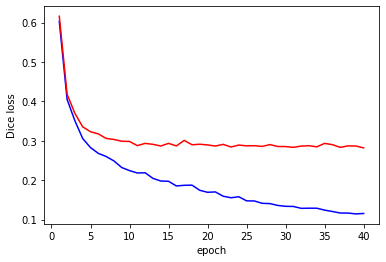

In [ ]:
train_checkpoint_val(augmented_train_batches_segmentation_3, 40, val_batches_segmentation_3)

In [ ]:
checkpoint.restore('./segmentation_model_3/tensorflow/checkpoints/ckpt-15')


In [ ]:
segmentation_model_3.save('segmentation_model_3/tensorflow/bst_model15.ckpt')


INFO:tensorflow:Assets written to: segmentation_model_3/tensorflow/bst_model15.ckpt/assets


##10.8 Tensorboard

In [ ]:
%tensorboard --logdir segmentation_model_3/tensorflow/

<IPython.core.display.Javascript object>

In [ ]:
segmentation_model_3_restored = load_model('segmentation_model_3/tensorflow/bst_model15.ckpt',custom_objects=dependencies_segmentation)

In [ ]:
score = segmentation_model_3_restored.evaluate(val_batches_segmentation_3,verbose=1) 
print("Validation Dice Loss:", score[0])
print("Validation Dice Coeff: ", score[1])

116/116 [==============================] - 7s 61ms/step - loss: 0.2934 - dice_coef_differentiable: 0.7075 - dice_coef: 0.7082
Validation Dice Loss: 0.2934073805809021
Validation Dice Coeff:  0.7074986696243286


##10.9 Evaluating on Test data dataset to see if the model us reproducible

In [ ]:
y_pred_prob= segmentation_model_3_restored.predict(test_batches_segmentation_3,verbose=1)
print(y_pred_prob.shape) 

517/517 [==============================] - 48s 92ms/step
(517, 256, 512, 1)


In [ ]:
print("Binary accuracy is :",sum([0 if i==0 else 1 for i in (y_pred_prob>0.5).astype(int).sum(axis=1).sum(axis=1).sum(axis=1)])/517)

Binary accuracy is : 0.9961315280464217


# Defect_4

##11.1 Train, Test and Val data

In [ ]:
X_train_4 = train_data_4['ImageId']
y_train_4 = train_data_4['Defect_4']
X_val_4 = val_data_4['ImageId']
y_val_4 = val_data_4['Defect_4']
X_test_4 = test_data_4['ImageId']
y_test_4 = test_data_4['Defect_4']

##11.2 Creating datset tensor

In [ ]:
train_dataset_4 = tf.data.Dataset.from_tensor_slices((X_train_4, y_train_4))
val_dataset_4 = tf.data.Dataset.from_tensor_slices((X_val_4, y_val_4))
test_dataset_4 = tf.data.Dataset.from_tensor_slices((X_test_4, y_test_4))

##11.3 Creating Train, Test and Val batches

##11.4 Model summary

In [ ]:
#https://www.tensorflow.org/tutorials/images/data_augmentation
BATCH_SIZE = 8
augmented_train_batches_segmentation_4 = (
    train_dataset_4
    .cache()
    .shuffle(X_train_4.shape[0]//4,reshuffle_each_iteration=True)
    # The augmentation is added here.
    .map(parse_function, num_parallel_calls=AUTOTUNE)
    # .map(augment, num_parallel_calls=AUTOTUNE)
    .map(image_resize)
    .batch(BATCH_SIZE)
    .prefetch(1)
)

val_batches_segmentation_4 = (
    val_dataset_4
    .cache()
    .map(parse_function, num_parallel_calls=AUTOTUNE)
    .map(image_resize)
    .batch(BATCH_SIZE)
    .prefetch(1)
)

test_batches_segmentation_4 = (
    test_dataset_4
    .cache()
    .map(parse_function, num_parallel_calls=AUTOTUNE)
    .map(image_resize)
    .batch(1)
    .prefetch(1)
)

augmented_test_batches_segmentation_4 = (
    test_dataset_4
    .cache()
    # The augmentation is added here.
    .map(parse_function, num_parallel_calls=AUTOTUNE)
    # .map(augment, num_parallel_calls=AUTOTUNE)
    .map(image_resize)
    .batch(1)
    .prefetch(1)
)

In [ ]:
from segmentation_models import Unet
#https://segmentation-models.readthedocs.io/en/latest/tutorial.htmlhttps://github.com/qubvel/segmentation_models
segmentation_model_4 = sm.Unet('efficientnetb1', input_shape= (256,512,3), classes=1, encoder_weights='imagenet', activation ='sigmoid')
segmentation_model_4.summary() 

Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            [(None, 256, 512, 3) 0                                            
__________________________________________________________________________________________________
stem_conv (Conv2D)              (None, 128, 256, 32) 864         input_5[0][0]                    
__________________________________________________________________________________________________
stem_bn (BatchNormalization)    (None, 128, 256, 32) 128         stem_conv[0][0]                  
__________________________________________________________________________________________________
stem_activation (Activation)    (None, 128, 256, 32) 0           stem_bn[0][0]                    
____________________________________________________________________________________________

##11.5 Checkpointing

In [ ]:
segmentation_model_4_optimizer = tf.keras.optimizers.Adam(1e-4)
start_epoch = tf.Variable(0)

In [ ]:
#https://www.tensorflow.org/guide/checkpoint
#Checkpointing model after every epoch
checkpoint = tf.train.Checkpoint(start_epoch=start_epoch, segmentation_model_4_optimizer = segmentation_model_4_optimizer,segmentation_model_4 = segmentation_model_4)
manager = tf.train.CheckpointManager(checkpoint, directory="./segmentation_model_4/tensorflow/checkpoints", max_to_keep=5)

In [ ]:
#https://www.tensorflow.org/tensorboard/get_started
#Checkpoinint loss and acc after every epoch for Tensorboard
# current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
train_log_dir = 'segmentation_model_4/tensorflow/logs/gradient_tape' + '/train'
val_log_dir = 'segmentation_model_4/tensorflow/logs/gradient_tape' + '/val'
train_summary_writer = tf.summary.create_file_writer(train_log_dir)
val_summary_writer = tf.summary.create_file_writer(val_log_dir)

##11.6 Training the model using gradient tape

In [ ]:
# Notice the use of `tf.function`
# This annotation causes the function to be "compiled" into a TF Graph
@tf.function
def train_step(images,labels):
    with tf.GradientTape() as model_tape:
      #Generating the model output
      model_output = segmentation_model_4(images,training=True)   
      #Calculating the model loss
      model_loss = dice_loss_differentiable(labels, model_output)

    gradients_of_model = model_tape.gradient(model_loss,segmentation_model_4.trainable_variables)
   
    segmentation_model_4_optimizer.apply_gradients(zip(gradients_of_model,segmentation_model_4.trainable_variables))
  

##11.7 Model Training

In [ ]:
def train_checkpoint_val(train_dataset_segmentation_4, epochs , val_dataset_segmentation_4):
  global start_epoch
  fig,ax = plt.subplots(1,1)
  ax.set_xlabel('epoch') ; ax.set_ylabel('Dice loss')
  xs, ytrs, yvals = [], [], []

  # Restoring from latest checkpoint if stored 
  checkpoint.restore(manager.latest_checkpoint)
  if manager.latest_checkpoint:
    print("Restored from {}".format(manager.latest_checkpoint))
  else:
    print("Initializing from scratch.")
   

  # Training the data 
  for epoch in range(start_epoch.numpy(), epochs):
    start = time.time()

    for images,labels in train_dataset_segmentation_4:
      # print(images.shape)
      # labels = tf.reshape(labels,(-1,1))
      # print(label.shape)
      train_step(images,labels) 
    
    stop = time.time()  
    
    #Increment the start_epoch to save it in checkpoint
    start_epoch.assign_add(1)
     
    # Save the model after every epoch 
    manager.save()

    segmentation_model_4.compile(optimizer=segmentation_model_4_optimizer, loss=dice_loss_differentiable, metrics=[dice_coef_differentiable,dice_coef])
    
    #Calculate train loss at the end of each epoch
    train_epoch_dice_loss_differentiable, train_epoch_dice_coef_differentiable ,train_epoch_dice_coef = segmentation_model_4.evaluate(train_dataset_segmentation_4,verbose=0)
    
    # Save the loss and acc for train
    with train_summary_writer.as_default():
      tf.summary.scalar('dice_loss_differentiable', train_epoch_dice_loss_differentiable, step=epoch)
      tf.summary.scalar('dice_coef_differentiable', train_epoch_dice_coef_differentiable, step=epoch) 
      tf.summary.scalar('dice_coef', train_epoch_dice_coef, step=epoch)   
     
    #Calculate val loss at the end of each epoch
    val_epoch_dice_loss_differentiable, val_epoch_dice_coef_differentiable , val_epoch_dice_coef = segmentation_model_4.evaluate(val_dataset_segmentation_4,verbose=0)

    # Save the loss and acc for val
    with val_summary_writer.as_default():
      tf.summary.scalar('dice_loss_differentiable', val_epoch_dice_loss_differentiable, step=epoch)
      tf.summary.scalar('dice_coef_differentiable', val_epoch_dice_coef_differentiable, step=epoch)  
      tf.summary.scalar('dice_coef', val_epoch_dice_coef, step=epoch)  
      

    xs.append(epoch+1)
    ytrs.append(train_epoch_dice_loss_differentiable)
    yvals.append(val_epoch_dice_loss_differentiable)   

    print ('epoch: {} - time: {} sec - train_dice_loss_differentiable: {} - train_dice_coef_differentiable: {} - train_dice_coef: {} - \
            val_dice_loss_differentiable: {} - val_dice_coef_differentiable: {} - val_dice_coef: {}-'.format(\
           epoch + 1, np.round(stop-start) ,np.round(train_epoch_dice_loss_differentiable,2),np.round(train_epoch_dice_coef_differentiable,2),np.round(train_epoch_dice_coef,2),
           np.round(val_epoch_dice_loss_differentiable,2),np.round(val_epoch_dice_coef_differentiable,2),np.round(val_epoch_dice_coef,2)))
  plt_dynamic(xs, ytrs, yvals, ax, fig)

Initializing from scratch.
epoch: 1 - time: 71.0 sec - train_dice_loss_differentiable: 0.78 - train_dice_coef_differentiable: 0.22 - train_dice_coef: 0.42 -             val_dice_loss_differentiable: 0.77 - val_dice_coef_differentiable: 0.23 - val_dice_coef: 0.43-
epoch: 2 - time: 20.0 sec - train_dice_loss_differentiable: 0.7 - train_dice_coef_differentiable: 0.3 - train_dice_coef: 0.56 -             val_dice_loss_differentiable: 0.69 - val_dice_coef_differentiable: 0.31 - val_dice_coef: 0.57-
epoch: 3 - time: 20.0 sec - train_dice_loss_differentiable: 0.61 - train_dice_coef_differentiable: 0.39 - train_dice_coef: 0.67 -             val_dice_loss_differentiable: 0.61 - val_dice_coef_differentiable: 0.39 - val_dice_coef: 0.65-
epoch: 4 - time: 20.0 sec - train_dice_loss_differentiable: 0.52 - train_dice_coef_differentiable: 0.48 - train_dice_coef: 0.72 -             val_dice_loss_differentiable: 0.53 - val_dice_coef_differentiable: 0.47 - val_dice_coef: 0.68-
epoch: 5 - time: 20.0 sec -

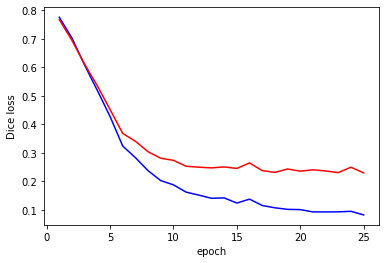

In [ ]:
train_checkpoint_val(augmented_train_batches_segmentation_4, 25, val_batches_segmentation_4)

In [ ]:
checkpoint.restore('./segmentation_model_4/tensorflow/checkpoints/ckpt-23')


In [ ]:
segmentation_model_4.save('segmentation_model_4/tensorflow/bst_model23.ckpt')


INFO:tensorflow:Assets written to: segmentation_model_4/tensorflow/bst_model23.ckpt/assets


##11.8 Tensorboard

In [ ]:
%tensorboard --logdir segmentation_model_4/tensorflow/

<IPython.core.display.Javascript object>

In [ ]:
segmentation_model_4_restored = load_model('segmentation_model_4/tensorflow/bst_model23.ckpt',custom_objects=dependencies_segmentation)

##11.9 Evaluating on Test data dataset to see if the model us reproducible

In [ ]:
score = segmentation_model_4_restored.evaluate(val_batches_segmentation_4,verbose=1) 
print("Validation Dice Loss:", score[0])
print("Validation Dice Coeff: ", score[1])

18/18 [==============================] - 1s 58ms/step - loss: 0.2305 - dice_coef_differentiable: 0.7695 - dice_coef: 0.7729
Validation Dice Loss: 0.23047924041748047
Validation Dice Coeff:  0.7695208191871643


In [ ]:
y_pred_prob= segmentation_model_4_restored.predict(test_batches_segmentation_4,verbose=1)
print(y_pred_prob.shape) 

87/87 [==============================] - 2s 20ms/step
(87, 256, 512, 1)


In [ ]:
print("Binary accuracy is :",sum([0 if i==0 else 1 for i in (y_pred_prob>0.5).astype(int).sum(axis=1).sum(axis=1).sum(axis=1)])/87)

Binary accuracy is : 1.0


##11. 10 Displaying original and predicted Images

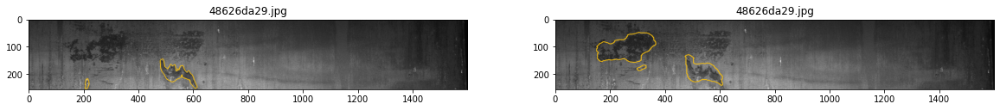

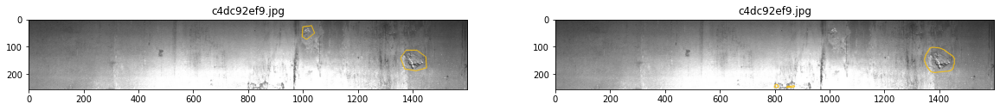

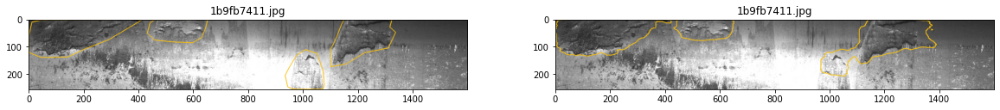

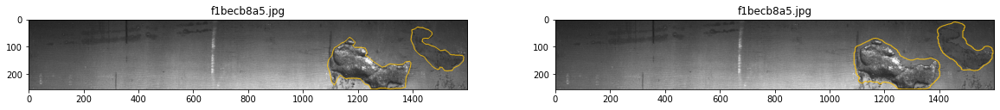

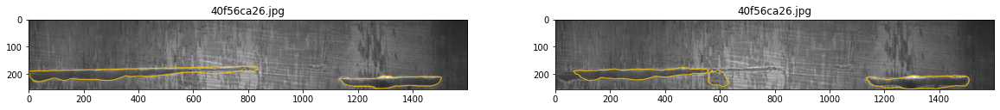

...

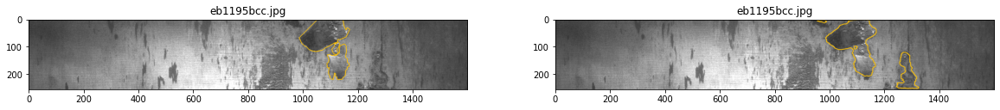

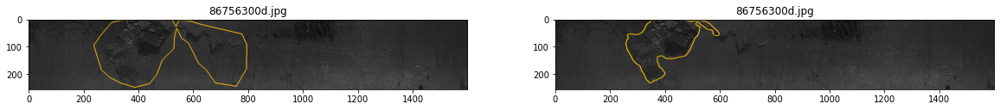

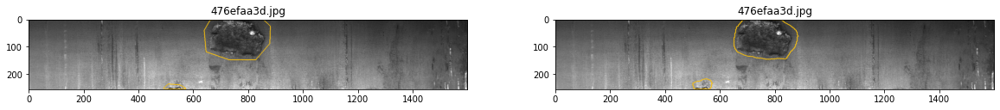

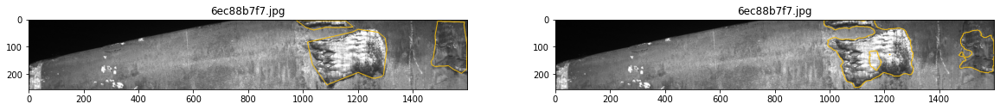

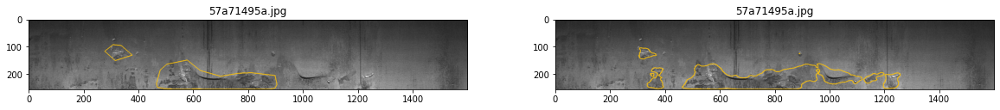

In [ ]:
for i in range(len(test_data_4.head(20))):
  fig, (a1,a2) = plt.subplots(1,2,figsize=(20, 20))
  name =test_data_4.iloc[i:i+1,:]['ImageId'].values[0]
  # print(type(name))
  # print(name)
  rle = test_data_4.iloc[i:i+1,:].iloc[:,1].iloc[0]
  # print(type(rle)) 
  true_mask = rle2mask(rle, (256,1600))
  true_mask = true_mask.astype('uint8')
  # true_mask = np.expand_dims(true_mask, -1)
  # print(true_mask.shape)
  pred_mask = (y_pred_prob[i,:,:,:]>0.5).astype(int).astype('uint8')
  # print(pred_mask.shape)
  pred_mask = cv2.resize(pred_mask,(1600,256))
  pred_mask = np.expand_dims(pred_mask, -1)
  # print(pred_mask.shape)
  show_mask_image(name,true_mask,a1,pred_mask,a2)
   

#12Lets use the Binary Models, Multilable model and Binary defect segmentation model

In [ ]:
X_train_data.head()

,ImageId,Defect_1,Defect_2,Defect_3,Defect_4,has_defect,has_defect_1,has_defect_2,has_defect_3,has_defect_4,no_of_defects
4494,5b922560e.jpg,NaN,NaN,NaN,NaN,0,0,0,0,0,0
6708,87f74731f.jpg,NaN,NaN,218601 10 218839 29 219077 47 219315 66 219399...,NaN,1,0,0,1,0,1
11506,e9c9ac12d.jpg,NaN,NaN,138243 127 138499 254 138755 254 139011 254 13...,NaN,1,0,0,1,0,1
10930,dde377e40.jpg,NaN,NaN,NaN,NaN,0,0,0,0,0,0
2656,358a4fc0c.jpg,NaN,NaN,NaN,NaN,0,0,0,0,0,0


In [ ]:
print(X_train_data.shape)
print(X_val_data.shape)
print(X_test_data.shape)

(9048, 11)
(2263, 11)
(1257, 11)


In [ ]:
X_train_data.head()

,ImageId,Defect_1,Defect_2,Defect_3,Defect_4,has_defect,has_defect_1,has_defect_2,has_defect_3,has_defect_4,no_of_defects
4494,5b922560e.jpg,NaN,NaN,NaN,NaN,0,0,0,0,0,0
6708,87f74731f.jpg,NaN,NaN,218601 10 218839 29 219077 47 219315 66 219399...,NaN,1,0,0,1,0,1
11506,e9c9ac12d.jpg,NaN,NaN,138243 127 138499 254 138755 254 139011 254 13...,NaN,1,0,0,1,0,1
10930,dde377e40.jpg,NaN,NaN,NaN,NaN,0,0,0,0,0,0
2656,358a4fc0c.jpg,NaN,NaN,NaN,NaN,0,0,0,0,0,0


In [ ]:
X_test_data.head()

,ImageId,Defect_1,Defect_2,Defect_3,Defect_4,has_defect,has_defect_1,has_defect_2,has_defect_3,has_defect_4,no_of_defects
11606,eb8fe7e47.jpg,NaN,NaN,154369 4 154625 11 154881 19 155137 26 155393 ...,NaN,1,0,0,1,0,1
2232,2d26bebd3.jpg,NaN,NaN,NaN,NaN,0,0,0,0,0,0
9010,b67f8ad07.jpg,NaN,NaN,NaN,NaN,0,0,0,0,0,0
6888,8bd35f020.jpg,NaN,NaN,373729 32 373921 96 374114 159 374306 223 3745...,NaN,1,0,0,1,0,1
8740,b14355f10.jpg,NaN,NaN,895 8 1136 23 1377 39 1619 53 1816 19 1860 68 ...,NaN,1,0,0,1,0,1


##12.1 Load the models

In [ ]:
model_binary_restored = load_model('binary_model/tensorflow/bst_model45.ckpt')
model_multilabel_defect_only_restored = load_model('multilable_model_defect_only/bst_model50.ckpt',custom_objects=dependencies_multilable)
model_defect_1_segmentation_restored = load_model('segmentation_model_1/tensorflow/bst_model41.ckpt',custom_objects=dependencies_segmentation)
model_defect_2_segmentation_restored = load_model('segmentation_model_2/tensorflow/bst_model63.ckpt',custom_objects=dependencies_segmentation)
model_defect_3_segmentation_restored = load_model('segmentation_model_3/tensorflow/bst_model15.ckpt',custom_objects=dependencies_segmentation)
model_defect_4_segmentation_restored = load_model('segmentation_model_4/tensorflow/bst_model23.ckpt',custom_objects=dependencies_segmentation)

##12.2  Area of Defect

In [ ]:
def area(rle):
    '''
    Input: EncodedPixels (str)
    Output: number of pixels having the defect
    '''
    return sum([int(pixel) for pixel in rle.split(' ')[1::2]])
'''
Area threshold for various defect types
    Defect 1 - 400
    Defect 2 - 500
    Defect 3 - 800
    Defect 4 - 1900
'''   

'\nArea threshold for various defect types\n    Defect 1 - 400\n    Defect 2 - 500\n    Defect 3 - 800\n    Defect 4 - 1900\n'

##12.3 Reading Images for classification task


In [ ]:
#https://cs230.stanford.edu/blog/datapipeline/
#https://www.tensorflow.org/guide/data

base_path ='train_images/'

#function to read the image and convert into pixel
def parse_function(image_path):
  image_string = tf.io.read_file(base_path+image_path)

  #Don't use tf.image.decode_image, or the output shape will be undefined
  image = tf.image.decode_jpeg(image_string, channels=3)

  #This will convert to float values in [0, 1]
  image = tf.image.convert_image_dtype(image, tf.float32)
  # print(image)
  # print(label)

  return image


#function to augment the images
def augment(image):
  image = tf.image.random_flip_left_right(image)
  image = tf.image.random_flip_up_down(image)
  image = tf.image.random_brightness(image, max_delta = 0.4)
  image = tf.image.random_crop(image, size=[224, 1568, 3])
  image = tf.clip_by_value(image, 0.0, 1.0)

  return image

#function to resize the images
def image_resize(image):
  resized_image = tf.image.resize(image, [256, 512])
  resized_image = tf.clip_by_value(resized_image, 0.0, 1.0)
  return resized_image

In [ ]:
X_train_data.head(1)

,ImageId,Defect_1,Defect_2,Defect_3,Defect_4,has_defect,has_defect_1,has_defect_2,has_defect_3,has_defect_4,no_of_defects
4494,5b922560e.jpg,NaN,NaN,NaN,NaN,0,0,0,0,0,0


In [ ]:
X_test_data.iloc[0:1]

,ImageId,Defect_1,Defect_2,Defect_3,Defect_4,has_defect,has_defect_1,has_defect_2,has_defect_3,has_defect_4,no_of_defects
11606,eb8fe7e47.jpg,NaN,NaN,154369 4 154625 11 154881 19 155137 26 155393 ...,NaN,1,0,0,1,0,1


##12.4 Function to predict

In [ ]:
# X can be a dataframe with an ImageId present
def pred_binary_multilable_classification_binary_segmentation(X):
    tta_steps = 1
    predictions_binary = []
    predictions_multilabel = []
    predictions_rles = []
    for i in tqdm(range(len(X))):
      img_name = X.iloc[i:i+1]['ImageId']
      dataset = tf.data.Dataset.from_tensor_slices(img_name).repeat(tta_steps)
      augmented_test_batches = (
          dataset
          .map(parse_function, num_parallel_calls=AUTOTUNE)
          .map(augment, num_parallel_calls=AUTOTUNE)
          .map(image_resize)
          .batch(1)
          .prefetch(1)
      )
      y_pred_prob_binary = model_binary_restored.predict(augmented_test_batches).mean()
      predictions_binary.append(y_pred_prob_binary)
      if y_pred_prob_binary<0.55:
        predictions_rles.append(['','','',''])
        predictions_multilabel.append(['','','',''])
      else:
        y_pred_prob_multilabel = model_multilabel_defect_only_restored.predict(augmented_test_batches).mean(axis=0)
        predictions_multilabel.append(y_pred_prob_multilabel)
      
        rles = []
        img_name_seg = X.iloc[i:i+1]['ImageId'].values[0]
        x_i = np.expand_dims(image_resize(parse_function(img_name_seg)),axis=0)
        for j in range(4):
          if j == 0:
            model_name = model_defect_1_segmentation_restored
          elif j == 1:
            model_name = model_defect_2_segmentation_restored
          elif j == 2:
            model_name = model_defect_3_segmentation_restored
          elif j == 3:
            model_name = model_defect_4_segmentation_restored      

          if y_pred_prob_multilabel[j]>0.55:
            y_pred_prob_seg = model_name.predict(x_i)
            mask = (y_pred_prob_seg>0.5).astype('uint8')
            mask = cv2.resize(mask[0,:,:,:],(1600,256)) 
            rle = mask2rle(mask)
            area_defect=area(rle)
            if (j==0 and area_defect>400) or (j==1 and area_defect>500) or (j==2 and area_defect>800) or (j==3 and area_defect>1900):
              rles.append(rle)
            else: rles.append('')
          else: rles.append('') 
        predictions_rles.append(rles)  

    X_binary_multilable_classification_binary_segmentation = pd.DataFrame(X['ImageId'],columns = ['ImageId','has_defect','has_defect_1','has_defect_2','has_defect_3','has_defect_4','Defect_1','Defect_2','Defect_3','Defect_4'])
    X_binary_multilable_classification_binary_segmentation['has_defect'] = predictions_binary 
    X_binary_multilable_classification_binary_segmentation[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']] = predictions_multilabel
    X_binary_multilable_classification_binary_segmentation[['Defect_1','Defect_2','Defect_3','Defect_4']]=predictions_rles

    return X_binary_multilable_classification_binary_segmentation 

##12.5 Function to calculate dice_coef

In [ ]:
def dice_coef(y_true, y_pred, smooth=K.epsilon()):
    intersection = K.sum(K.sum(y_true * K.round(y_pred),axis=1),axis=1)
    return K.mean((2. * intersection + smooth) / (K.sum(K.sum(y_true,axis=1),axis=1) + 
                                                       K.sum(K.sum(K.round(y_pred),axis=1),axis=1) + smooth)) 

##12.6 Function to convert mask2rle and rle2mask

In [ ]:
#https://www.kaggle.com/cdeotte/keras-unet-with-eda#%20https://www.kaggle.com/cdeotte/keras-unet-with-eda
def rle2mask_4(rle,shape=(256,1600)):
  mask = np.zeros((shape[0], shape[1], 4), dtype=np.uint8)
  for idx, label in enumerate(rle):
    if label is not np.nan and label is not '':
      mask_label = np.zeros(shape[0]*shape[1], dtype=np.uint8)
      label = label.split(" ")
      positions = map(int, label[0::2])
      length = map(int, label[1::2])
      for pos, le in zip(positions, length):
        mask_label[pos-1:pos+le-1] = 1
      mask[:, :, idx] = mask_label.reshape(shape[0], shape[1], order='F')
  return mask           

def mask2rle(mask):
    mask_flatten = mask.flatten(order = 'F')
    # We will create another mask shifted by one digit and compare side by side
    masks_flatten_append0 = np.concatenate([[0], mask_flatten, [0]])
    runs = np.where(masks_flatten_append0[1:] != masks_flatten_append0[:-1])[0]+1
    runs[1::2] -= runs[::2]
    return ' '.join(str(x) for x in runs)

# for Training segmentation models we would need both the image pixels and the mask pixels and just output labels
# Hence we would need to have a custom generator which will take the image id and generate the image pixels
# and also oitput mask and then together that can be sent to the model. We will also need to create batches


##12.6 Dice_coef calculation

In [ ]:
# Generate true_y_mask and pred_y_mask during metric calculation
def dice_coef_metric_calculation(source_df,predicted_df ,dim=(256,1600), n_classes=4):
  indexes = np.arange(len(source_df))
  y_true = np.empty((len(source_df), *dim, n_classes), dtype=int)
  y_pred = np.empty((len(source_df), *dim, n_classes), dtype=int)     
  for i, ID in enumerate(indexes):
    
    if n_classes != 1:
      rles_true = source_df[['Defect_1','Defect_2','Defect_3','Defect_4']].iloc[ID].values
      masks = rle2mask_4(rles_true, (256,1600))
  
      y_true[i,] = masks
      rles_pred = predicted_df[['Defect_1','Defect_2','Defect_3','Defect_4']].iloc[ID].values
      masks = rle2mask_4(rles_pred, (256,1600))
   
      
      y_pred[i,] = masks
    # y = (y > 0).astype(int)
    dice_coef_calculated = dice_coef(y_true.astype(np.float32),y_pred.astype(np.float32))
  return dice_coef_calculated.numpy()

##12.7 Function to format the results

In [ ]:
def get_defect(X,new_df):
  has_defect = []
  for i in range(len(X)):
    if all((X['Defect_1'].iloc[i]=='',X['Defect_2'].iloc[i]=='',X['Defect_3'].iloc[i]=='',X['Defect_4'].iloc[i]=='')):
      has_defect.append(0)
    else:
      has_defect.append(1)
  new_df['has_defect'] = has_defect

  has_defect_1 = []
  for i in range(len(X)):
    if X['Defect_1'].iloc[i]=='':
      has_defect_1.append(0)
    else:
      has_defect_1.append(1)
  new_df['has_defect_1'] = has_defect_1

  has_defect_2 = []
  for i in range(len(X)):
    if X['Defect_2'].iloc[i]=='':
      has_defect_2.append(0)
    else:
      has_defect_2.append(1)
  new_df['has_defect_2'] = has_defect_2

  has_defect_3 = []
  for i in range(len(X)):
    if X['Defect_3'].iloc[i]=='':
      has_defect_3.append(0)
    else:
      has_defect_3.append(1)
  new_df['has_defect_3'] = has_defect_3

  has_defect_4 = []
  for i in range(len(X)):
    if X['Defect_4'].iloc[i]=='':
      has_defect_4.append(0)
    else:
      has_defect_4.append(1)
  new_df['has_defect_4'] = has_defect_4 
  return(new_df)   

##12.8 Test_Data

In [ ]:
X_binary_multilable_classification_binary_segmentation_test  =pred_binary_multilable_classification_binary_segmentation(X_test_data)

### Binary Accuracy

In [ ]:
accuracy_score(X_test_data[['has_defect']].values,(X_binary_multilable_classification_binary_segmentation_test[['has_defect']].values>0.6).astype(int))

0.9291964996022275

## Dice_Coeff

In [ ]:
dice_coef_predictions=[]
for i in tqdm(range(len(X_test_data))):
  dice_coef_pred=dice_coef_metric_calculation(X_test_data.iloc[i:i+1],X_binary_multilable_classification_binary_segmentation_test.iloc[i:i+1])
  dice_coef_predictions.append(dice_coef_pred)

In [ ]:
print("The average Dice_coef is:",np.mean(dice_coef_predictions))

The average Dice_coef is: 0.9214827


## Binary Classification

In [ ]:
new_df_test = pd.DataFrame(X_binary_multilable_classification_binary_segmentation_test['ImageId'],
                            columns = ['ImageId','has_defect','has_defect_1','has_defect_2','has_defect_3','has_defect_4'])

In [ ]:
new_df_test =get_defect(X_binary_multilable_classification_binary_segmentation_test,new_df_test)

In [ ]:
print(confusion_matrix(X_test_data['has_defect'].values,new_df_test['has_defect'].values))
print(classification_report(X_test_data['has_defect'].values,new_df_test['has_defect'].values))

[[566  24]
 [ 76 591]]
              precision    recall  f1-score   support

           0       0.88      0.96      0.92       590
           1       0.96      0.89      0.92       667

    accuracy                           0.92      1257
   macro avg       0.92      0.92      0.92      1257
weighted avg       0.92      0.92      0.92      1257



## Multilable Classification

Test_accuracy: 0.8647573587907716
              precision    recall  f1-score   support

           0       0.91      0.50      0.65        82
           1       0.61      0.58      0.60        24
           2       0.90      0.87      0.88       517
           3       0.97      0.68      0.80        87

   micro avg       0.89      0.80      0.84       710
   macro avg       0.85      0.66      0.73       710
weighted avg       0.90      0.80      0.84       710
 samples avg       0.44      0.43      0.43       710

-------------------- Confusion matrix --------------------


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in samples with no true labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


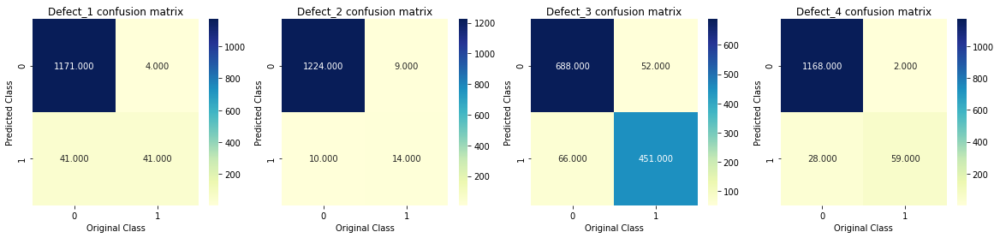

In [ ]:
test_Accuracy = accuracy_score(X_test_data[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']].values,
                               new_df_test[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']].values)
print("Test_accuracy:", test_Accuracy)
print(classification_report(X_test_data[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']].values,
                               new_df_test[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']].values))
print("-"*20, "Confusion matrix", "-"*20)
fig, ax = plt.subplots(1,4,figsize=(20,4))
j=0
for i in multilabel_confusion_matrix(X_test_data[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']].values,
                               new_df_test[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']].values):

  labels = [0,1]
  sns.heatmap(i, annot=True, cmap="YlGnBu", fmt=".3f", xticklabels=labels, yticklabels=labels,ax = ax[j])
  ax[j].set_ylabel('Predicted Class')
  ax[j].set_xlabel('Original Class')
  ax[j].set_title(f'Defect_{j+1} confusion matrix')
  j=j+1
plt.show()

##12.9 Test_Data with Test Time Augmentation

In [ ]:
X_binary_multilable_classification_binary_segmentation_test  =pred_binary_multilable_classification_binary_segmentation(X_test_data)

### Binary Accuracy

In [ ]:
accuracy_score(X_test_data[['has_defect']].values,(X_binary_multilable_classification_binary_segmentation_test[['has_defect']].values>0.6).astype(int))

0.9387430389817024

## Dice_Coeff

In [ ]:
dice_coef_predictions=[]
for i in tqdm(range(len(X_test_data))):
  dice_coef_pred=dice_coef_metric_calculation(X_test_data.iloc[i:i+1],X_binary_multilable_classification_binary_segmentation_test.iloc[i:i+1])
  dice_coef_predictions.append(dice_coef_pred)

In [ ]:
print("The average Dice_coef is:",np.mean(dice_coef_predictions))

The average Dice_coef is: 0.9290187


## Binary Classification

In [ ]:
new_df_test = pd.DataFrame(X_binary_multilable_classification_binary_segmentation_test['ImageId'],
                            columns = ['ImageId','has_defect','has_defect_1','has_defect_2','has_defect_3','has_defect_4'])

In [ ]:
new_df_test =get_defect(X_binary_multilable_classification_binary_segmentation_test,new_df_test)

In [ ]:
print(confusion_matrix(X_test_data['has_defect'].values,new_df_test['has_defect'].values))
print(classification_report(X_test_data['has_defect'].values,new_df_test['has_defect'].values))

[[576  14]
 [ 68 599]]
              precision    recall  f1-score   support

           0       0.89      0.98      0.93       590
           1       0.98      0.90      0.94       667

    accuracy                           0.93      1257
   macro avg       0.94      0.94      0.93      1257
weighted avg       0.94      0.93      0.93      1257



## Multilable Classification

Test_accuracy: 0.883054892601432
              precision    recall  f1-score   support

           0       0.88      0.51      0.65        82
           1       0.71      0.62      0.67        24
           2       0.92      0.89      0.90       517
           3       0.97      0.70      0.81        87

   micro avg       0.91      0.81      0.86       710
   macro avg       0.87      0.68      0.76       710
weighted avg       0.91      0.81      0.85       710
 samples avg       0.45      0.44      0.44       710

-------------------- Confusion matrix --------------------


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in samples with no true labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


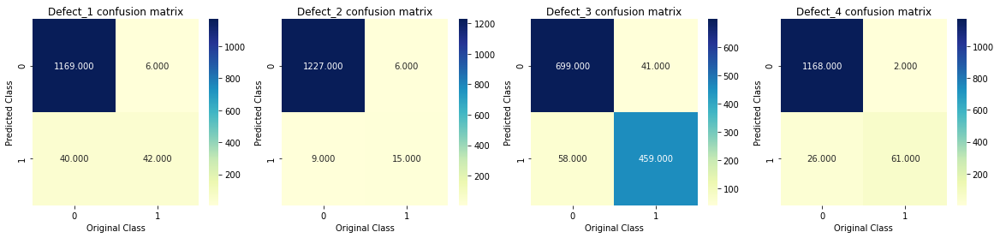

In [ ]:
test_Accuracy = accuracy_score(X_test_data[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']].values,
                               new_df_test[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']].values)
print("Test_accuracy:", test_Accuracy)
print(classification_report(X_test_data[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']].values,
                               new_df_test[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']].values))
print("-"*20, "Confusion matrix", "-"*20)
fig, ax = plt.subplots(1,4,figsize=(20,4))
j=0
for i in multilabel_confusion_matrix(X_test_data[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']].values,
                               new_df_test[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']].values):

  labels = [0,1]
  sns.heatmap(i, annot=True, cmap="YlGnBu", fmt=".3f", xticklabels=labels, yticklabels=labels,ax = ax[j])
  ax[j].set_ylabel('Predicted Class')
  ax[j].set_xlabel('Original Class')
  ax[j].set_title(f'Defect_{j+1} confusion matrix')
  j=j+1
plt.show()

##12.10 Val_Data

In [ ]:
X_binary_multilable_classification_binary_segmentation_val  = pred_binary_multilable_classification_binary_segmentation(X_val_data)

## Binary Accuracy

In [ ]:
accuracy_score(X_val_data[['has_defect']].values,(X_binary_multilable_classification_binary_segmentation_val[['has_defect']].values>0.6).astype(int))

0.9200176756517897

## Dice_coef

In [ ]:
dice_coef_predictions=[]
for i in tqdm(range(len(X_val_data))):
  dice_coef_pred=dice_coef_metric_calculation(X_val_data.iloc[i:i+1],X_binary_multilable_classification_binary_segmentation_val.iloc[i:i+1])
  dice_coef_predictions.append(dice_coef_pred)

In [ ]:
print("The average Dice_coef is:",np.mean(dice_coef_predictions))

The average Dice_coef is: 0.92665684


## Binary Classification

In [ ]:
new_df_val = pd.DataFrame(X_binary_multilable_classification_binary_segmentation_val['ImageId'],
                            columns = ['ImageId','has_defect','has_defect_1','has_defect_2','has_defect_3','has_defect_4'])

In [ ]:
new_df_val =get_defect(X_binary_multilable_classification_binary_segmentation_val,new_df_val)

In [ ]:
print(confusion_matrix(X_val_data['has_defect'].values,new_df_val['has_defect'].values))
print(classification_report(X_val_data['has_defect'].values,new_df_val['has_defect'].values))

[[1001   62]
 [ 134 1066]]
              precision    recall  f1-score   support

           0       0.88      0.94      0.91      1063
           1       0.95      0.89      0.92      1200

    accuracy                           0.91      2263
   macro avg       0.91      0.92      0.91      2263
weighted avg       0.92      0.91      0.91      2263



## Multilable Classification

Test_accuracy: 0.8616880247459126
              precision    recall  f1-score   support

           0       0.88      0.65      0.75       162
           1       0.83      0.50      0.62        50
           2       0.89      0.87      0.88       922
           3       0.91      0.74      0.82       144

   micro avg       0.89      0.81      0.85      1278
   macro avg       0.88      0.69      0.77      1278
weighted avg       0.89      0.81      0.85      1278
 samples avg       0.45      0.44      0.44      1278

-------------------- Confusion matrix --------------------


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in samples with no true labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


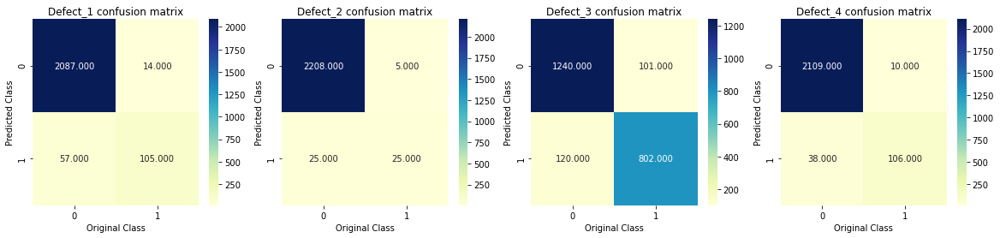

In [ ]:
val_Accuracy = accuracy_score(X_val_data[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']].values,
                               new_df_val[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']].values)
print("Test_accuracy:", val_Accuracy)
print(classification_report(X_val_data[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']].values,
                               new_df_val[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']].values))
print("-"*20, "Confusion matrix", "-"*20)
fig, ax = plt.subplots(1,4,figsize=(20,4))
j=0
for i in multilabel_confusion_matrix(X_val_data[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']].values,
                               new_df_val[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']].values):

  labels = [0,1]
  sns.heatmap(i, annot=True, cmap="YlGnBu", fmt=".3f", xticklabels=labels, yticklabels=labels,ax = ax[j])
  ax[j].set_ylabel('Predicted Class')
  ax[j].set_xlabel('Original Class')
  ax[j].set_title(f'Defect_{j+1} confusion matrix')
  j=j+1
plt.show()

## 12.11 Train_data

In [ ]:
X_binary_multilable_classification_binary_segmentation_train  =pred_binary_multilable_classification_binary_segmentation(X_train_data)

### Binary Accuracy

In [ ]:
accuracy_score(X_train_data[['has_defect']].values,(X_binary_multilable_classification_binary_segmentation_train[['has_defect']].values>0.6).astype(int))

0.9382183908045977

## Dice_Coeff

In [ ]:
dice_coef_predictions=[]
for i in tqdm(range(len(X_train_data))):
  dice_coef_pred=dice_coef_metric_calculation(X_train_data.iloc[i:i+1],X_binary_multilable_classification_binary_segmentation_train.iloc[i:i+1])
  dice_coef_predictions.append(dice_coef_pred)

In [ ]:
print("The average Dice_coef is:",np.mean(dice_coef_predictions))

The average Dice_coef is: 0.94582206


## Binary Classification

In [ ]:
new_df_train = pd.DataFrame(X_binary_multilable_classification_binary_segmentation_train['ImageId'],
                            columns = ['ImageId','has_defect','has_defect_1','has_defect_2','has_defect_3','has_defect_4'])

In [ ]:
new_df_train =get_defect(X_binary_multilable_classification_binary_segmentation_train,new_df_train)

In [ ]:
print(confusion_matrix(X_train_data['has_defect'].values,new_df_train['has_defect'].values))
print(classification_report(X_train_data['has_defect'].values,new_df_train['has_defect'].values))

[[4084  165]
 [ 446 4353]]
              precision    recall  f1-score   support

           0       0.90      0.96      0.93      4249
           1       0.96      0.91      0.93      4799

    accuracy                           0.93      9048
   macro avg       0.93      0.93      0.93      9048
weighted avg       0.93      0.93      0.93      9048



## Multilable Classification

Test_accuracy: 0.8884836427939876
              precision    recall  f1-score   support

           0       0.93      0.64      0.76       653
           1       0.77      0.53      0.63       173
           2       0.92      0.90      0.91      3711
           3       0.95      0.75      0.84       570

   micro avg       0.92      0.84      0.88      5107
   macro avg       0.89      0.70      0.78      5107
weighted avg       0.92      0.84      0.87      5107
 samples avg       0.46      0.45      0.45      5107

-------------------- Confusion matrix --------------------


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in samples with no true labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


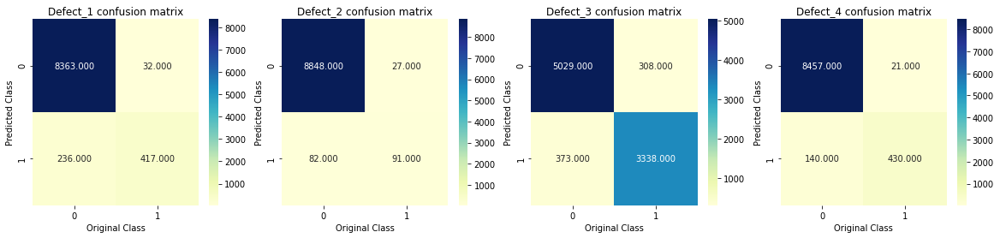

In [ ]:
train_Accuracy = accuracy_score(X_train_data[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']].values,
                               new_df_train[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']].values)
print("Test_accuracy:", train_Accuracy)
print(classification_report(X_train_data[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']].values,
                               new_df_train[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']].values))
print("-"*20, "Confusion matrix", "-"*20)
fig, ax = plt.subplots(1,4,figsize=(20,4))
j=0
for i in multilabel_confusion_matrix(X_train_data[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']].values,
                               new_df_train[['has_defect_1','has_defect_2','has_defect_3','has_defect_4']].values):

  labels = [0,1]
  sns.heatmap(i, annot=True, cmap="YlGnBu", fmt=".3f", xticklabels=labels, yticklabels=labels,ax = ax[j])
  ax[j].set_ylabel('Predicted Class')
  ax[j].set_xlabel('Original Class')
  ax[j].set_title(f'Defect_{j+1} confusion matrix')
  j=j+1
plt.show()

#13 Summary

In [ ]:
print('*'*70)
print('Dataset            ',' '*5,'Train_Data',' '*5,'Val_Data',' '*5,'Test_Data',' '*5,'Test_Data_tta')
print('Dice_Coef          ',' '*5,'   94.6',' '*5,'      92',' '*5,'     92.5',' '*5,'     92.9')
print('Binary_Accuracy    ',' '*5,'   93.8',' '*5,'      92.5',' '*5,'       92',' '*5, '       94')
print('Multilabel_Accuracy',' '*5,'   88.8',' '*5,'    86.5',' '*5,'     86.5',' '*5,'     88')

**********************************************************************
Dataset                   Train_Data       Val_Data       Test_Data       Test_Data_tta
Dice_Coef                    94.6             92            92.5            92.9
Binary_Accuracy              93.8             92.5              92              94
Multilabel_Accuracy          88.8           86.5            86.5            88
